## Bigram Model

In [ ]:
from google.colab import drive, files

drive.mount("/content/gdrive")

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
%cd /content/gdrive/MyDrive/prog

/content/gdrive/MyDrive/prog


In [ ]:
!git clone https://github.com/Gklajer/makemore.git

Cloning into 'makemore'...
remote: Enumerating objects: 67, done.
remote: Counting objects: 100% (26/26), done.
remote: Compressing objects: 100% (10/10), done.
remote: Total 67 (delta 21), reused 16 (delta 16), pack-reused 41
Receiving objects: 100% (67/67), 123.95 KiB | 933.00 KiB/s, done.
Resolving deltas: 100% (37/37), done.


In [ ]:
%cd /content/gdrive/MyDrive/prog/makemore
files.view("/content/gdrive/MyDrive/prog/makemore")

/content/gdrive/MyDrive/prog/makemore


<IPython.core.display.Javascript object>

In [ ]:
names = open("names.txt", "r").read().splitlines()
names = list(set(names))
names[:10]

['delphina',
 'musab',
 'theoden',
 'jordanny',
 'annaclaire',
 'delsa',
 'shenaya',
 'mckenlee',
 'waylyn',
 'bianka']

In [ ]:
len(names)

29494

In [ ]:
min(len(name) for name in names)

2

In [ ]:
max(len(name) for name in names)

15

In [ ]:
name0 = name = f".{names[0]}."
[chr1 + chr2 for chr1, chr2 in zip(name0, name0[1:])]

['.d', 'de', 'el', 'lp', 'ph', 'hi', 'in', 'na', 'a.']

In [ ]:
from collections import defaultdict

bigrams_counts = defaultdict(int)

for name in names:
    name = f".{name}."
    for bi in zip(name, name[1:]):
        bigrams_counts[bi] += 1

chars = sorted(list(set(".".join(names))))
bigrams_counts = {
    (chr1, chr2): bigrams_counts[(chr1, chr2)] for chr1 in chars for chr2 in chars
}
sorted(bigrams_counts.items())[:10]

[(('.', '.'), 0),
 (('.', 'a'), 4131),
 (('.', 'b'), 1150),
 (('.', 'c'), 1387),
 (('.', 'd'), 1571),
 (('.', 'e'), 1430),
 (('.', 'f'), 383),
 (('.', 'g'), 615),
 (('.', 'h'), 795),
 (('.', 'i'), 549)]

In [ ]:
import torch

counts = torch.IntTensor(list(bigrams_counts.values())).view(len(chars), len(chars))
counts[:10, :10]

tensor([[   0, 4131, 1150, 1387, 1571, 1430,  383,  615,  795,  549],
        [6474,  544,  525,  422,  974,  646,  130,  152, 2240, 1541],
        [ 110,  302,   35,    1,   65,  624,    0,    0,   40,  197],
        [  92,  733,    0,   37,    1,  491,    0,    2,  600,  263],
        [ 487, 1220,    1,    3,  137, 1164,    5,   23,  116,  621],
        [3641,  650,  116,  137,  361, 1195,   80,  104,  142,  792],
        [  78,  235,    0,    0,    0,  114,   41,    1,    1,  147],
        [  99,  292,    2,    0,   19,  308,    1,   21,  341,  178],
        [2304, 2097,    6,    2,   23,  628,    2,    2,    1,  701],
        [2218, 2335,  109,  476,  406, 1537,   94,  399,   92,   79]],
       dtype=torch.int32)

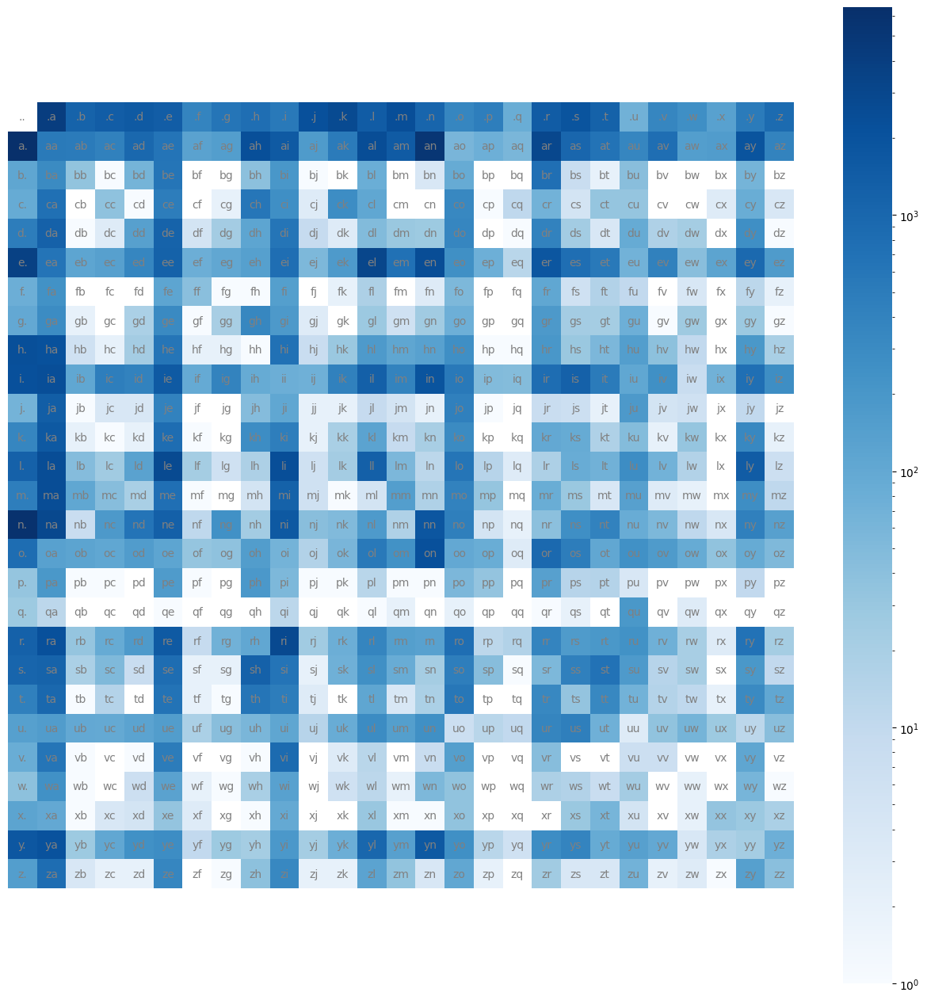

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
from seaborn import heatmap

%matplotlib inline

plt.figure(figsize=(16, 16))
annot = np.array([[chr1 + chr2 for chr2 in chars] for chr1 in chars])
ax = heatmap(
    counts,
    norm=LogNorm(),
    square=True,
    cmap="Blues",
    annot=annot,
    fmt=".2s",
    annot_kws={"color": "grey"},
)
plt.axis("off")
plt.show()

In [ ]:
from bidict import bidict

(itoc := bidict(enumerate(chars)))

bidict({0: '.', 1: 'a', 2: 'b', 3: 'c', 4: 'd', 5: 'e', 6: 'f', 7: 'g', 8: 'h', 9: 'i', 10: 'j', 11: 'k', 12: 'l', 13: 'm', 14: 'n', 15: 'o', 16: 'p', 17: 'q', 18: 'r', 19: 's', 20: 't', 21: 'u', 22: 'v', 23: 'w', 24: 'x', 25: 'y', 26: 'z'})

In [ ]:
SEED = 2147483647
rg = torch.Generator().manual_seed(SEED)
P = counts + 1
P = P / P.sum(1, keepdim=True)

for _ in range(10):
    i = 0
    name = ""
    while (
        i := torch.multinomial(
            P[i], num_samples=1, replacement=True, generator=rg
        ).item()
    ) != 0:
        name += itoc[i]

    print(name)

junide
janasah
p
cony
a
nn
kohin
tolia
s
tee


In [ ]:
nll = 0
for name in names[:3]:
    name = f".{name}."
    for chr1, chr2 in zip(name, name[1:]):
        i = itoc.inverse[chr1]
        j = itoc.inverse[chr2]

        p = P[i, j].item()
        nlogp = -np.log(p)
        print(f"{chr1}{chr2}: {p=:.3f} {nlogp=:.3f}")

        nll += nlogp

print(f"\n{nll=:.3f}")

.d: p=0.053 nlogp=2.933
de: p=0.228 nlogp=1.478
el: p=0.163 nlogp=1.814
lp: p=0.001 nlogp=6.766
ph: p=0.197 nlogp=1.623
hi: p=0.097 nlogp=2.329
in: p=0.118 nlogp=2.140
na: p=0.172 nlogp=1.760
a.: p=0.202 nlogp=1.599
.m: p=0.080 nlogp=2.520
mu: p=0.022 nlogp=3.821
us: p=0.154 nlogp=1.871
sa: p=0.152 nlogp=1.885
ab: p=0.016 nlogp=4.109
b.: p=0.045 nlogp=3.092
.t: p=0.041 nlogp=3.205
th: p=0.121 nlogp=2.112
he: p=0.087 nlogp=2.439
eo: p=0.013 nlogp=4.308
od: p=0.023 nlogp=3.782
de: p=0.228 nlogp=1.478
en: p=0.127 nlogp=2.061
n.: p=0.355 nlogp=1.036

nll=60.161


## Model

In [1]:
import os

DIR = "data"

FILENAME1 = "tinyshakespeare.txt"
FILENAME2 = "taylorswift.txt"

PATH1 = os.path.join(DIR, FILENAME1)
PATH2 = os.path.join(DIR, FILENAME2)

URL1 = "https://raw.githubusercontent.com/karpathy/char-rnn/master/data/tinyshakespeare/input.txt"
URL2 = "https://raw.githubusercontent.com/karpathy/minbpe/master/tests/taylorswift.txt"

In [2]:
!wget -O  {PATH1} {URL1}
!wget -O  {PATH2} {URL2}

--2024-05-16 11:05:06--  https://raw.githubusercontent.com/karpathy/char-rnn/master/data/tinyshakespeare/input.txt
Résolution de raw.githubusercontent.com (raw.githubusercontent.com)… 185.199.109.133, 185.199.111.133, 185.199.108.133, ...
Connexion à raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443… connecté.
requête HTTP transmise, en attente de la réponse… 

200 OK
Taille : 1115394 (1,1M) [text/plain]
Sauvegarde en : « data/tinyshakespeare.txt »

data/tinyshakespear 100%[===================>]   1,06M  --.-KB/s    ds 0,07s   

2024-05-16 11:05:07 (14,4 MB/s) — « data/tinyshakespeare.txt » sauvegardé [1115394/1115394]

--2024-05-16 11:05:07--  https://raw.githubusercontent.com/karpathy/minbpe/master/tests/taylorswift.txt
Résolution de raw.githubusercontent.com (raw.githubusercontent.com)… 185.199.109.133, 185.199.111.133, 185.199.108.133, ...
Connexion à raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443… connecté.
requête HTTP transmise, en attente de la réponse… 200 OK
Taille : 185768 (181K) [text/plain]
Sauvegarde en : « data/taylorswift.txt »

data/taylorswift.tx 100%[===================>] 181,41K  --.-KB/s    ds 0,1s    

2024-05-16 11:05:07 (1,74 MB/s) — « data/taylorswift.txt » sauvegardé [185768/185768]



In [3]:
with open(PATH1, "r", encoding="utf-8") as f:
    train = f.read()

print(train[:1000])

First Citizen:
Before we proceed any further, hear me speak.

All:
Speak, speak.

First Citizen:
You are all resolved rather to die than to famish?

All:
Resolved. resolved.

First Citizen:
First, you know Caius Marcius is chief enemy to the people.

All:
We know't, we know't.

First Citizen:
Let us kill him, and we'll have corn at our own price.
Is't a verdict?

All:
No more talking on't; let it be done: away, away!

Second Citizen:
One word, good citizens.

First Citizen:
We are accounted poor citizens, the patricians good.
What authority surfeits on would relieve us: if they
would yield us but the superfluity, while it were
wholesome, we might guess they relieved us humanely;
but they think we are too dear: the leanness that
afflicts us, the object of our misery, is as an
inventory to particularise their abundance; our
sufferance is a gain to them Let us revenge this with
our pikes, ere we become rakes: for the gods know I
speak this in hunger for bread, not in thirst for revenge.



In [4]:
len(train)

1115394

In [5]:
chars = sorted(list(set(train)))
r"".join(chars)

"\n !$&',-.3:;?ABCDEFGHIJKLMNOPQRSTUVWXYZabcdefghijklmnopqrstuvwxyz"

In [6]:
with open(PATH2, "r", encoding="utf-8") as f:
    test = f.read()

print(test[:1000])

Copy paste of the Wikipedia article on Taylor Swift, as of Feb 16, 2024.
---

Main menu

WikipediaThe Free Encyclopedia

Search
Create account
Log in

Personal tools
Contents  hide
(Top)
Life and career
Toggle Life and career subsection
Artistry
Toggle Artistry subsection
Accolades and achievements
Cultural status
Toggle Cultural status subsection
Wealth
Toggle Wealth subsection
Discography
Filmography
Tours
See also
Footnotes
References
Toggle References subsection
External links
Taylor Swift

136 languages
Article
Talk
Read
View source
View history

Tools
 Featured article
Page semi-protected
From Wikipedia, the free encyclopedia
For the album, see Taylor Swift (album).
Taylor Swift
Portrait of Taylor Swift in a cocktail dress
Swift at the 2023 MTV Video Music Awards
Born	Taylor Alison Swift
December 13, 1989 (age 34)
West Reading, Pennsylvania, US
Occupations
Singer-songwriter producer director businesswoman actress
Years active	2004–present
Works
Albumssinglessongsvideosperformance

In [7]:
r"".join(sorted(list(set(test))))

'\t\n !"#$&\'()+,-./0123456789:;?@ABCDEFGHIJKLMNOPQRSTUVWXYZ[]abcdefghijklmnopqrstuvwxyz£®áéíñö–—•™'

In [8]:
from utils.tokenizer import BasicTokenizer

BATCH_SIZE = 2048
BLOCK_SIZE = 64
VOCAB_SIZE = 256
D_EMBD = 128
N_HEADS = 16
N_EXPERTS = 4
K_TOP = 2
N_BLOCKS = 8
DROP_RATE = .2

tokenizer = BasicTokenizer(VOCAB_SIZE, train, verbose=True)

assert tokenizer.decode(tokenizer.encode(test)) == test

Start merging


In [9]:
import torch
import torch.multiprocessing as mp

mp.set_start_method("spawn", force=True)

if torch.cuda.is_available():
    for i in range(torch.cuda.device_count()):
        device = torch.device(f"cuda:{i}")
        torch.cuda.set_device(device)
        
        props = torch.cuda.get_device_properties(device)
        print(f"Device {i}:")
        print(f"   Name: {props.name}")
        print(f"   Total Memory: {props.total_memory / 1024**2}MB")
        print(
            f"   Allocated Memory: {torch.cuda.memory_allocated(device) / 1024**2}MB\n"
        )


else:
    device = torch.device("cpu")
    print("CUDA is not available.")

torch.set_default_device(device)

Device 0:
   Name: NVIDIA RTX A6000
   Total Memory: 48676.75MB
   Allocated Memory: 0.0MB

Device 1:
   Name: NVIDIA RTX A6000
   Total Memory: 48676.75MB
   Allocated Memory: 0.0MB



In [10]:
data = torch.tensor(tokenizer.encode(train), dtype=torch.long)

N = int(0.9 * len(data))

train_data = data[:N]
val_data = data[N:]

train_data.size(), val_data.size()

(torch.Size([1003854]), torch.Size([111540]))

In [11]:
from torch.utils.data import DataLoader
from utils.dataset import BlockDataset

SEED = 2147483647
rg = torch.Generator(device).manual_seed(SEED)

train_ds = BlockDataset(train_data, BLOCK_SIZE)
val_ds = BlockDataset(val_data, BLOCK_SIZE)

train_dl = DataLoader(
    train_ds,
    sampler=torch.utils.data.RandomSampler(
        train_ds,
        num_samples=len(train_ds),
        generator=rg,
    ),
    shuffle=False,
    batch_size=BATCH_SIZE,
    drop_last=True,
    num_workers=32,
)

val_dl = DataLoader(
    val_ds,
    sampler=torch.utils.data.RandomSampler(
        val_ds, 
        num_samples=len(train_ds), 
        generator=rg
    ),
    shuffle=False,
    batch_size=BATCH_SIZE,
    drop_last=True,
    num_workers=32,
)

x, y = next(iter(train_dl))

for b in range(BATCH_SIZE):
    print(f"\n{b+1}/{BATCH_SIZE}")
    print('(context) ->  (target)')
    for t in range(BLOCK_SIZE):
        print(f"{x[b, :t+1].tolist()} -> {y[b, t]}")
    print()

[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated b


1/2048
(context) ->  (target)
[115] -> 105
[115, 105] -> 103
[115, 105, 103] -> 110
[115, 105, 103, 110] -> 44
[115, 105, 103, 110, 44] -> 10
[115, 105, 103, 110, 44, 10] -> 66
[115, 105, 103, 110, 44, 10, 66] -> 117
[115, 105, 103, 110, 44, 10, 66, 117] -> 116
[115, 105, 103, 110, 44, 10, 66, 117, 116] -> 32
[115, 105, 103, 110, 44, 10, 66, 117, 116, 32] -> 100
[115, 105, 103, 110, 44, 10, 66, 117, 116, 32, 100] -> 117
[115, 105, 103, 110, 44, 10, 66, 117, 116, 32, 100, 117] -> 114
[115, 105, 103, 110, 44, 10, 66, 117, 116, 32, 100, 117, 114] -> 115
[115, 105, 103, 110, 44, 10, 66, 117, 116, 32, 100, 117, 114, 115] -> 116
[115, 105, 103, 110, 44, 10, 66, 117, 116, 32, 100, 117, 114, 115, 116] -> 32
[115, 105, 103, 110, 44, 10, 66, 117, 116, 32, 100, 117, 114, 115, 116, 32] -> 110
[115, 105, 103, 110, 44, 10, 66, 117, 116, 32, 100, 117, 114, 115, 116, 32, 110] -> 111
[115, 105, 103, 110, 44, 10, 66, 117, 116, 32, 100, 117, 114, 115, 116, 32, 110, 111] -> 116
[115, 105, 103, 110, 44, 1

In [12]:
from utils.model import LanguageModel

model = LanguageModel(BLOCK_SIZE, VOCAB_SIZE, D_EMBD, N_HEADS, N_EXPERTS, K_TOP, N_BLOCKS, DROP_RATE)
print(model)

LanguageModel(
  (tok_embd): Embedding(256, 128)
  (pos_embd): Embedding(64, 128)
  (blocks): Sequential(
    (0): TransformerBlock(
      (sa): MultiHeadAttention(
        (heads): ModuleList(
          (0-15): 16 x Head(
            (query): Linear(in_features=128, out_features=8, bias=False)
            (key): Linear(in_features=128, out_features=8, bias=False)
            (value): Linear(in_features=128, out_features=8, bias=False)
            (dropout): Dropout(p=0.2, inplace=False)
          )
        )
        (proj): Linear(in_features=128, out_features=128, bias=True)
      )
      (moe): SparselyGatedMoE(
        (topk_gate): NoisyTopKGating(
          (gate): Linear(in_features=128, out_features=4, bias=True)
          (var): Sequential(
            (0): Linear(in_features=128, out_features=4, bias=True)
            (1): Softplus(beta=1.0, threshold=20.0)
          )
        )
        (experts): ModuleList(
          (0-3): 4 x FeedForward(
            (fc1): Linear(in_featu

In [13]:
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-3)

for ep in range(1):
    print(f"Epoch {ep}:<")
    print(":")
    for x, targets in train_dl:
        model.train()

        optimizer.zero_grad()

        loss = model(x, targets)
        loss.backward()

        optimizer.step()

        print(loss.item())

    model.eval()
    print(sum(model(x, targets).item() for x, targets in val_dl) / len(val_dl))

Epoch 0:<
:


[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated before all shared CUDA tensors released. See Note [Sharing CUDA tensors]
[W CudaIPCTypes.cpp:16] Producer process has been terminated b

RuntimeError: The size of tensor a (128) must match the size of tensor b (4) at non-singleton dimension 2

In [ ]:
print(tokenizer.decode(model(x[:1])[0].cpu().numpy()))

LO:
It is in mine authority to command
The keys of all the posterns: please your highness
To take the urgent hour. Come, sir, away.

PRINCE EDWARD:
I would grave.

To WICK:
Aror the good art that peach to the patter? fort
Maruesses, at your shall t's the KING RICHARD III:
Where I should thou stand Edword!

CORIOLANUS:
Brone, m deach


In [ ]:
y[:1].numpy()

TypeError: can't convert cuda:1 device type tensor to numpy. Use Tensor.cpu() to copy the tensor to host memory first.

In [ ]:
tokenizer.decode(y[:1].numpy())

TypeError: only integer scalar arrays can be converted to a scalar index

### Extraction attacks

In [ ]:
import argparse


def main():
    print(f"using device: {device}")
    # number of tokens to generate
    seq_len = 256

    # sample from the top_k tokens output by the model
    top_k = 40

    print("Loading GPT2...")
    tokenizer = GPT2Tokenizer.from_pretrained("gpt2")
    tokenizer.padding_side = "left"
    tokenizer.pad_token = tokenizer.eos_token

    model1 = GPT2LMHeadModel.from_pretrained("gpt2-xl", return_dict=True).to(device)
    model1.config.pad_token_id = model1.config.eos_token_id
    model2 = GPT2LMHeadModel.from_pretrained("gpt2", return_dict=True).to(device)
    model1.eval()
    model2.eval()

    samples = []
    scores = {"XL": [], "S": [], "Lower": [], "zlib": []}

    num_batches = int(np.ceil(args.N / args.batch_size))
    with tqdm(total=args.N) as pbar:
        for i in range(num_batches):
            # encode the prompts
            if args.internet_sampling:
                # pick a random 10-token prompt in common crawl

                input_len = 10
                input_ids = []
                attention_mask = []

                while len(input_ids) < args.batch_size:
                    # take some random words in common crawl
                    r = np.random.randint(0, len(cc))
                    prompt = " ".join(cc[r : r + 100].split(" ")[1:-1])

                    # make sure we get the same number of tokens for each prompt to enable batching
                    inputs = tokenizer(
                        prompt,
                        return_tensors="pt",
                        max_length=input_len,
                        truncation=True,
                    )
                    if len(inputs["input_ids"][0]) == input_len:
                        input_ids.append(inputs["input_ids"][0])
                        attention_mask.append(inputs["attention_mask"][0])

                inputs = {
                    "input_ids": torch.stack(input_ids),
                    "attention_mask": torch.stack(attention_mask),
                }

                # the actual truncated prompts
                prompts = tokenizer.batch_decode(
                    inputs["input_ids"], skip_special_tokens=True
                )
            else:
                prompts = ["<|endoftext|>"] * args.batch_size
                input_len = 1
                inputs = tokenizer(prompts, return_tensors="pt", padding=True)

            # batch generation
            output_sequences = model1.generate(
                input_ids=inputs["input_ids"].to(device),
                attention_mask=inputs["attention_mask"].to(device),
                max_length=input_len + seq_len,
                do_sample=True,
                top_k=top_k,
                top_p=1.0,
            )

            texts = tokenizer.batch_decode(output_sequences, skip_special_tokens=True)

            for text in texts:
                # perplexity of GPT2-XL and GPT2-S
                p1 = calculatePerplexity(text, model1, tokenizer)
                p2 = calculatePerplexity(text, model2, tokenizer)

                # perplexity on lower-case sample
                p_lower = calculatePerplexity(text.lower(), model1, tokenizer)

                samples.append(text)
                scores["XL"].append(p1)
                scores["S"].append(p2)
                scores["Lower"].append(p_lower)
                scores["zlib"].append(zlib_entropy)

            pbar.update(args.batch_size)

    scores["XL"] = np.asarray(scores["XL"])
    scores["S"] = np.asarray(scores["S"])
    scores["Lower"] = np.asarray(scores["Lower"])
    scores["zlib"] = np.asarray(scores["zlib"])

    # Sort by perplexity
    metric = -np.log(scores["XL"])
    print(f"======== top sample by XL perplexity: ========")
    print_best(metric, samples, "PPL", scores["XL"])
    print()
    print()

    # Sort by ratio of log perplexities of S and XL models
    metric = np.log(scores["S"]) / np.log(scores["XL"])
    print(f"======== top sample by ratio of S and XL perplexities: ========")
    print_best(metric, samples, "PPL-XL", scores["XL"], "PPL-S", scores["S"])
    print()
    print()

    # Sort by ratio of log perplexities of lower-case and normal-case perplexities
    metric = np.log(scores["Lower"]) / np.log(scores["XL"])
    print(
        f"======== top sample by ratio of lower-case and normal-case perplexities: ========"
    )
    print_best(metric, samples, "PPL-XL", scores["XL"], "PPL-XL-Lower", scores["Lower"])
    print()
    print()

    # Sort by ratio of Zlib entropy and XL perplexity
    metric = scores["zlib"] / np.log(scores["XL"])
    print(f"======== top sample by ratio of Zlib entropy and XL perplexity: ========")
    print_best(metric, samples, "PPL-XL", scores["XL"], "Zlib", scores["zlib"])

In [ ]:
%pip uninstall -y transformers
%pip install git+https://github.com/huggingface/transformers

  Cloning https://github.com/huggingface/transformers to /tmp/pip-req-build-66vltnnw
  Running command git clone --filter=blob:none --quiet https://github.com/huggingface/transformers /tmp/pip-req-build-66vltnnw
  Resolved https://github.com/huggingface/transformers to commit 12c5544dca0fbef4d85c9dbe7aefef29b86b7905
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for transformers: filename=transformers-4.41.0.dev0-py3-none-any.whl size=9039103 sha256=d12d6976901ca93a08722f121255c232284afa9d1f10228183700667bdab1019
  Stored in directory: /tmp/pip-ephem-wheel-cache-68qda79_/wheels/c0/14/d6/6c9a5582d2ac191ec0a483be151a4495fe1eb2a6706ca49f1b
Successfully built transformers


In [ ]:
%pip install accelerate

In [ ]:
# Load model directly
import torch
from transformers import AutoModelForCausalLM, AutoTokenizer, pipeline

torch.random.manual_seed(0)

tokenizer = AutoTokenizer.from_pretrained("epfl-llm/meditron-7b")
model = AutoModelForCausalLM.from_pretrained(
    "epfl-llm/meditron-7b",
    device_map="cuda",
    torch_dtype="auto",
    trust_remote_code=True,
    return_dict=True,
)

pipe = pipeline(
    "text-generation",
    model=model,
    tokenizer=tokenizer,
)

In [ ]:
from transformers import BertForSequenceClassification, Trainer, TrainingArguments

model = BertForSequenceClassification.from_pretrained("bert-large-uncased")

training_args = TrainingArguments(
    output_dir="./results",  # output directory
    num_train_epochs=3,  # total # of training epochs
    per_device_train_batch_size=16,  # batch size per device during training
    per_device_eval_batch_size=64,  # batch size for evaluation
    warmup_steps=500,  # number of warmup steps for learning rate scheduler
    weight_decay=0.01,  # strength of weight decay
    logging_dir="./logs",  # directory for storing logs
)

trainer = Trainer(
    model=model,  # the instantiated 🤗 Transformers model to be trained
    args=training_args,  # training arguments, defined above
    train_dataset=train_dataset,  # training dataset
    eval_dataset=test_dataset,  # evaluation dataset
)

In [ ]:
import numpy as np
from pprint import pprint
import torch
import zlib
from transformers import GPT2Tokenizer, GPT2LMHeadModel
from tqdm import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


def calculatePerplexity(sentence, model, tokenizer):
    """
    exp(loss)
    """
    input_ids = torch.tensor(tokenizer.encode(sentence)).unsqueeze(0)
    input_ids = input_ids.to(device)
    with torch.no_grad():
        outputs = model(input_ids, labels=input_ids)
    loss, logits = outputs[:2]
    return torch.exp(loss)


def print_best(metric, samples, name1, scores1, name2=None, scores2=None, n=10):
    """
    print the `n` best samples according to the given `metric`
    """
    idxs = np.argsort(metric)[::-1][:n]

    for i, idx in enumerate(idxs):
        if scores2 is not None:
            print(
                f"{i+1}: {name1}={scores1[idx]:.3f}, {name2}={scores2[idx]:.3f}, score={metric[idx]:.3f}"
            )
        else:
            print(f"{i+1}: {name1}={scores1[idx]:.3f}, , score={metric[idx]:.3f}")

        print()
        # for line in samples[idx].split("\n"):
        #    print(f"\t {line.rstrip()}")
        pprint(samples[idx])
        print()
        print()

In [ ]:
generation_args = {
    "max_new_tokens": 500,
    "return_full_text": False,
    "do_sample": False,
}

messages = ["What about solving an 2x + 3 = 7 equation?", ""]

output = pipe(messages, **generation_args)

In [ ]:
model.eval()

LlamaForCausalLM(
  (model): LlamaModel(
    (embed_tokens): Embedding(32017, 4096)
    (layers): ModuleList(
      (0-31): 32 x LlamaDecoderLayer(
        (self_attn): LlamaSdpaAttention(
          (q_proj): Linear(in_features=4096, out_features=4096, bias=False)
          (k_proj): Linear(in_features=4096, out_features=4096, bias=False)
          (v_proj): Linear(in_features=4096, out_features=4096, bias=False)
          (o_proj): Linear(in_features=4096, out_features=4096, bias=False)
          (rotary_emb): LlamaRotaryEmbedding()
        )
        (mlp): LlamaMLP(
          (gate_proj): Linear(in_features=4096, out_features=11008, bias=False)
          (up_proj): Linear(in_features=4096, out_features=11008, bias=False)
          (down_proj): Linear(in_features=11008, out_features=4096, bias=False)
          (act_fn): SiLU()
        )
        (input_layernorm): LlamaRMSNorm()
        (post_attention_layernorm): LlamaRMSNorm()
      )
    )
    (norm): LlamaRMSNorm()
  )
  (lm_head):

In [ ]:
inputs = tokenizer(messages, return_tensors="pt", padding=True).to("cuda")

model.model(**inputs).shape

OutOfMemoryError: CUDA out of memory. Tried to allocate 2.00 MiB. GPU 0 has a total capacity of 14.75 GiB of which 1.06 MiB is free. Process 36816 has 14.74 GiB memory in use. Of the allocated memory 14.50 GiB is allocated by PyTorch, and 125.56 MiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)